In [2]:
import matplotlib
import matplotlib.pyplot as plt 
from matplotlib.collections import LineCollection
import numpy as np
import pandas as pd
import os
import umap
import datashader as ds
import colorcet as cc
import igraph
import tqdm
from sklearn.neighbors import NearestNeighbors
import leidenalg as la

from dredFISH.Analysis import TissueGraph
from dredFISH.Analysis import Classification
from dredFISH.Visualization import Viz

from dredFISH.Utils.__init__plots import * 
from dredFISH.Utils import powerplots

import importlib
importlib.reload(Viz)
importlib.reload(Classification)
importlib.reload(TissueGraph)

<module 'dredFISH.Analysis.TissueGraph' from '/bigstore/GeneralStorage/fangming/projects/dredfish/packages/dredFISH/dredFISH/Analysis/TissueGraph.py'>

# Tasks
- streamline code
- save results (data frame)
- save figure panels (to be assembled into 1 PDF)

In [29]:
def split_half(x, y, line_seg, consistency='large_x'):
    """
    Consistency=None: does not care left vs right
     = 'large_x': always select the right half
    """
    [[p1x, p1y], [p2x, p2y]] = line_seg
    vx = p2x-p1x
    vy = p2y-p1y
    vn = np.array([-vy, vx]) # normal to the line
    v = np.vstack([x-p1x,y-p1y]).T
    
    cond = v.dot(vn) < 0 # sign split points into left and right
    
    if consistency is None:
        return cond
    elif consistency == "large_x": # select the right hemisphere (bigger x)
        if np.mean(x[cond]) < np.mean(x[~cond]):
            cond = ~cond
        return cond

def adjust_XY_byline(line_seg, XY):
    """
    """
    [[p1x, p1y], [p2x, p2y]] = line_seg
    # line direction
    v = np.array([p2x-p1x, p2y-p1y])
    v = v/np.linalg.norm(v, 2)
    vx, vy = v
    # always points up
    if vy < 0:
        v = -v
    # theta
    theta = np.arccos(v.dot([0,1]))
    if vx < 0:
        theta = -theta
    
    # rotate counter clock wise by theta
    R = np.array([
        [np.cos(theta), -np.sin(theta),], 
        [np.sin(theta),  np.cos(theta),], 
        ])
    XYnew = XY.dot(R.T)
    
    return XYnew

In [20]:
def leiden(G, cells,
           resolution=1, seed=0, n_iteration=2,
           **kwargs,
          ):
    """cells are in order
    """
    partition = la.find_partition(G, 
                                  la.RBConfigurationVertexPartition, # modularity with resolution
                                  resolution_parameter=resolution, seed=seed, n_iterations=n_iteration, **kwargs)
    # get cluster labels from partition
    labels = [0]*(len(cells)) 
    for i, cluster in enumerate(partition):
        for element in cluster:
            labels[element] = i+1
    return labels

#### Load data

In [5]:
respath = '/bigstore/GeneralStorage/fangming/projects/dredfish/figures/'
# build on top of basepth
basepth = '/bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3'
!ls -alhtr $basepth
!head $basepth"/TMG.json"

total 90M
drwxrwxrwx 7 zach     wollmanlab 4.0K Jul  8 12:44 ..
lrwxrwxrwx 1 fangming wollmanlab   69 Jul  8 12:45 DPNMF_PolyA_2021Nov19_Section_-1850X_270Y_metadata.csv -> ../Dataset1-t1/DPNMF_PolyA_2021Nov19_Section_-1850X_270Y_metadata.csv
lrwxrwxrwx 1 fangming wollmanlab   67 Jul  8 12:45 DPNMF_PolyA_2021Nov19_Section_-1850X_270Y_matrix.csv -> ../Dataset1-t1/DPNMF_PolyA_2021Nov19_Section_-1850X_270Y_matrix.csv
-rw-r--r-- 1 fangming wollmanlab  165 Jul 12 14:29 TMG.json
-rw-r--r-- 1 fangming wollmanlab  54M Jul 12 14:29 cell.h5ad
-rw-r--r-- 1 fangming wollmanlab 6.8M Jul 12 14:29 isozone.h5ad
-rw-r--r-- 1 fangming wollmanlab 700K Jul 12 14:29 region.h5ad
-rw-r--r-- 1 fangming wollmanlab    3 Jul 12 14:29 Taxonomy_clusters.csv
-rw-r--r-- 1 fangming wollmanlab    3 Jul 12 14:29 Taxonomy_topics.csv
drwxr-xr-x 2 fangming wollmanlab 4.0K Jul 18 10:34 .
-rw-r--r-- 1 fangming wollmanlab  30M Jul 18 13:19 analysis_dev_v2.csv
{"layers_graph": [[0, 1], [0, 2]], "layer_taxonomy_mapping": {"0":

In [6]:
# load TMG - with a cell layer
TMG = TissueGraph.TissueMultiGraph(basepath=basepth, 
                                   redo=False, # load existing 
                                  )
TMG

/bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/cell.h5ad
/bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/isozone.h5ad
/bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/region.h5ad


In [14]:
# stuff needed from it
# spatial coordinates
layer = TMG.Layers[0]

XY = layer.XY
x, y = XY[:,0], XY[:,1]
###
x, y = y, x # a temporary hack
XY = np.vstack([x,y]).T
###

N = layer.N

# measured basis
ftrs_mat = layer.feature_mat

# add to a df 
df = pd.DataFrame()
df['x'] = x
df['y'] = y
for i in range(24):
    df[f'b{i}'] = ftrs_mat[:,i]
df

,x,y,b0,b1,b2,b3,b4,b5,b6,b7,...,b14,b15,b16,b17,b18,b19,b20,b21,b22,b23
0,1911.666962,-1749.638192,-0.603849,1.714861,0.594060,0.139496,1.509942,-0.114950,-0.383432,-0.130503,...,-1.042621,-0.377495,-1.338384,-1.124956,-0.155036,-0.286638,-0.387834,-0.117224,-0.410755,1.181027
1,1850.678429,-1747.172043,-0.530279,1.681959,1.301185,-0.464006,1.570054,-0.461933,-0.492565,-0.030743,...,-1.203702,-0.556397,-1.356768,-0.828398,-0.328228,-0.286638,-0.932215,-0.271226,-0.222204,1.127544
2,1515.123295,-1746.940031,-0.603849,-0.362498,0.620053,-1.128423,1.206578,-2.549739,-0.601243,-0.362521,...,-0.648550,-0.232972,-1.052768,0.648169,-0.999444,-0.286638,-0.556354,-0.144253,0.490684,2.188804
3,1426.161788,-1748.456394,-0.298989,1.023065,1.517082,-0.341796,0.475449,0.173852,-0.408143,-0.355103,...,-0.788941,-0.282583,-0.611566,-0.450966,0.128447,-0.286638,-0.721338,0.160502,-0.223867,0.029698
4,1739.792930,-1749.407386,-0.603849,-1.351786,1.025515,-1.128423,0.327118,-1.435450,-0.138725,-0.340307,...,-0.761760,-0.927360,-1.564878,-0.801772,1.826586,-0.286638,-1.689133,0.265159,-1.215811,1.532146
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77841,-2188.756848,-1084.480934,-0.603849,-0.271399,-0.666686,0.269214,0.821624,-0.652041,-0.195764,0.272682,...,0.200085,0.508830,-0.120465,0.859582,-0.367392,-0.286638,1.523995,-0.829305,0.446156,-0.338945
77842,-2257.822983,-1083.270665,0.936062,0.386319,-0.614982,1.752306,0.067531,0.282673,-0.074560,-0.010770,...,0.525392,-0.027365,-0.013067,0.760336,-0.100553,-0.286638,-0.447374,0.035593,-0.106235,-0.503376
77843,-2475.320577,-1083.995803,-0.603849,-0.228163,-0.612215,0.895132,0.247026,-0.901201,-0.484248,0.922900,...,0.134591,-0.110296,0.118158,1.764126,-0.434788,1.756892,-0.534186,-0.061414,0.108948,-0.438144
77844,-2311.578984,-1086.717336,-0.603849,-1.153599,0.699586,-0.204732,1.546018,0.460290,-0.279114,-0.694249,...,0.183778,1.903259,-0.663014,0.873821,0.287583,-0.286638,-0.295560,-0.354058,0.229195,-1.402028


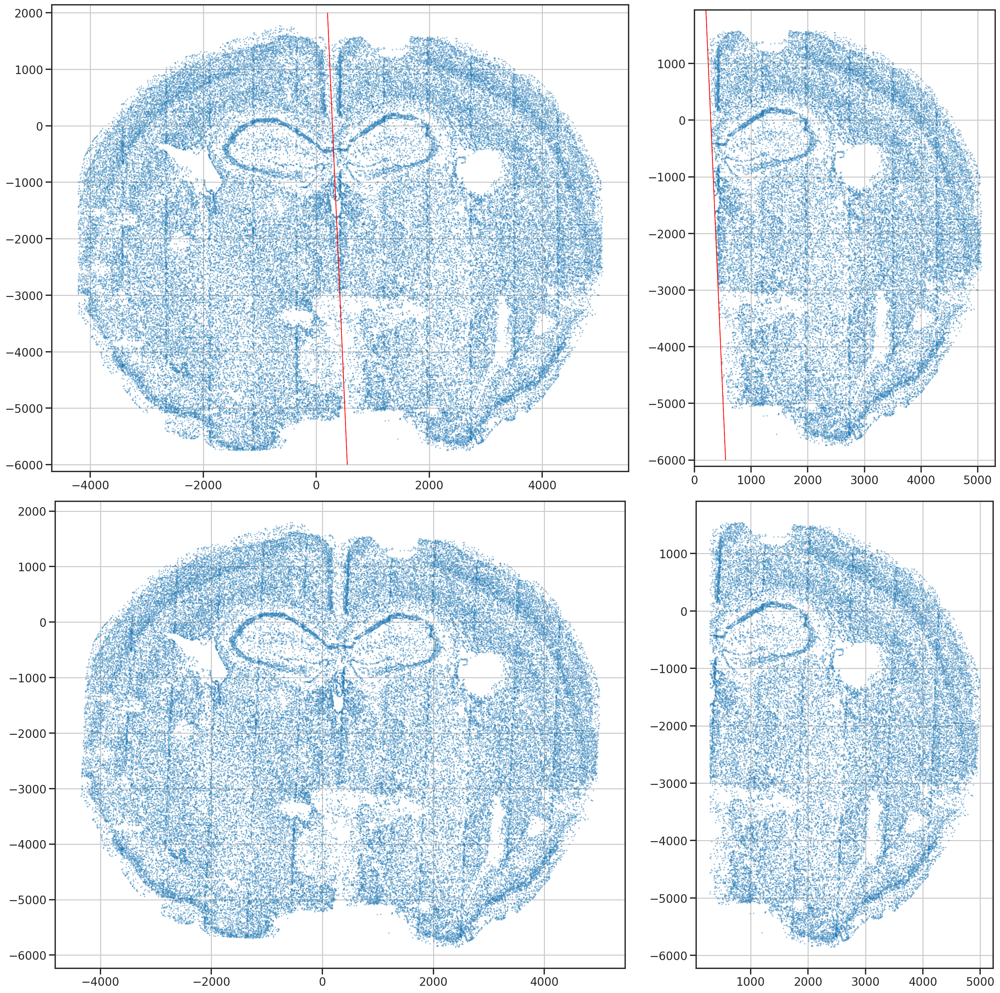

In [43]:
# define a line to split things into hemi-coronal sections

# try
line_segs = [
    # [(0,0),(1,1)],
    [(550, -6000), (200, 2000)],
    [(200, 2000), (550, -6000)],
]

# split and adjust
cond = split_half(x, y, line_segs[0])    
XYnew = adjust_XY_byline(line_segs[0], XY)
xnew, ynew = XYnew[:,0], XYnew[:,1]

# fig, axs = plt.subplots(2, 2, figsize=(15*2,10*2))
mosaic="""
AAB
CCD
"""
fig = plt.figure(figsize=(20,20), constrained_layout=True)
axs_dict = fig.subplot_mosaic(mosaic)
for i, (key, ax) in enumerate(axs_dict.items()):
    if i == 0:
        ax.scatter(x, y, s=0.1)
        lc = LineCollection(line_segs, linewidth=1, colors='r') 
        ax.add_collection(lc)
    elif i == 1:
        ax.scatter(x[cond], y[cond], s=0.1)
        lc = LineCollection(line_segs, linewidth=1, colors='r') 
        ax.add_collection(lc)
    elif i == 2:
        ax.scatter(xnew, ynew, s=0.1)
    elif i == 3:
        ax.scatter(xnew[cond], ynew[cond], s=0.1)
    ax.set_aspect('equal')

plt.show()

In [31]:
# add results
df['x2'] = XYnew[:,0]
df['y2'] = XYnew[:,1]
df['semi'] = cond.astype(int)

In [ ]:
# save
df.to_csv(os.path.join(basepth, "analysis_dev_v2.csv"), header=True, index=True)

In [6]:
# UMAP
umap_mat = umap.UMAP(n_neighbors=30, min_dist=0.1, random_state=0).fit_transform(ftrs_mat)

# add to a df 
df['umap_x'] = umap_mat[:,0]
df['umap_y'] = umap_mat[:,1]
df

In [ ]:
%%time
# create known cell type classifier and train and predict
allen_classifier = Classification.KnownCellTypeClassifier(
    layer, 
    tax_name='Allen_types',
    ref='allen_smrt_dpnmf',
    ref_levels=['class_label', 'neighborhood_label', 'subclass_label'], #, 'cluster_label'], 
    model='knn',
)
allen_classifier.train(verbose=True)
type_mat = allen_classifier.classify()

# add to a df
for i in range(3):
    df[f'ktype_L{i+1}'] = type_mat[:,i]
df

In [ ]:
%%time
# feature graph to generete cell types
G = layer.FG
cells = layer.adata.obs.index.values
resolutions = [0.01, 0.02, 0.05, 0.1, 0.2, 0.5, 1,2,5,10]

for r in tqdm.tqdm(resolutions):
    types = leiden(G, cells, resolution=r)
    # add to a df 
    df[f'type_r{r}'] = np.char.add('t', np.array(types).astype(str))
df

100%|██████████| 10/10 [00:35<00:00,  3.53s/it]

CPU times: user 35.1 s, sys: 175 ms, total: 35.3 s
Wall time: 35.3 s


,x,y,umap_x,umap_y,b0,b1,b2,b3,b4,b5,...,type_r0.01,type_r0.02,type_r0.05,type_r0.1,type_r0.2,type_r0.5,type_r1,type_r2,type_r5,type_r10
0,1911.666962,-1749.638192,-2.029191,-2.311490,-0.603849,1.714861,0.594060,0.139496,1.509942,-0.114950,...,t1,t1,t1,t3,t2,t5,t7,t3,t50,t37
1,1850.678429,-1747.172043,-1.967202,-2.240022,-0.530279,1.681959,1.301185,-0.464006,1.570054,-0.461933,...,t1,t1,t1,t3,t2,t5,t7,t3,t50,t37
2,1515.123295,-1746.940031,0.129711,1.281505,-0.603849,-0.362498,0.620053,-1.128423,1.206578,-2.549739,...,t1,t1,t1,t3,t2,t10,t10,t6,t44,t38
3,1426.161788,-1748.456394,-0.984896,1.910701,-0.298989,1.023065,1.517082,-0.341796,0.475449,0.173852,...,t1,t1,t1,t3,t2,t10,t10,t6,t47,t110
4,1739.792930,-1749.407386,2.211790,0.787992,-0.603849,-1.351786,1.025515,-1.128423,0.327118,-1.435450,...,t1,t1,t1,t1,t1,t1,t2,t5,t16,t10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77841,-2188.756848,-1084.480934,-6.829121,3.687545,-0.603849,-0.271399,-0.666686,0.269214,0.821624,-0.652041,...,t1,t1,t1,t4,t5,t8,t12,t20,t57,t71
77842,-2257.822983,-1083.270665,-7.990279,4.465511,0.936062,0.386319,-0.614982,1.752306,0.067531,0.282673,...,t1,t1,t3,t4,t5,t8,t12,t8,t2,t42
77843,-2475.320577,-1083.995803,-7.563236,3.869554,-0.603849,-0.228163,-0.612215,0.895132,0.247026,-0.901201,...,t1,t1,t2,t2,t4,t6,t8,t23,t43,t70
77844,-2311.578984,-1086.717336,1.922534,0.974157,-0.603849,-1.153599,0.699586,-0.204732,1.546018,0.460290,...,t1,t1,t1,t1,t1,t1,t3,t16,t49,t114


In [ ]:
# save
df.to_csv(os.path.join(basepth, "analysis_dev_v2.csv"), header=True, index=True)

# Viz

In [13]:
def plot_basis_spatial(df, pmode='full'):
    if pmode == 'full':
        nx, ny = 6, 4
        panel_x, panel_y = 6, 5
        wspace, hspace = 0.05, 0
        title_loc = 'left'
        title_y = 0.9
    elif pmode == 'left_half':
        nx, ny = 6, 4
        panel_x, panel_y = 3, 5
        wspace, hspace = 0.05, 0
        title_loc = 'left'
        title_y = 0.9
    elif pmode == 'right_half':
        nx, ny = 6, 4
        panel_x, panel_y = 3, 5
        wspace, hspace = 0.05, 0
        title_loc = 'right'
        title_y = 0.9
    else:
        raise ValueError("No such mode")
        
    path = os.path.join(respath, 'basis_space.pdf')
    P = powerplots.PlotScale(df['x'].max()-df['x'].min(), 
                             df['y'].max()-df['y'].min(),
                             # npxlx=300,
                             pxl_scale=20,
                            )
    print(P.npxlx, P.npxly)

    fig, axs = plt.subplots(ny, nx, figsize=(nx*panel_x, ny*panel_y))
    for i in range(24):
        ax = axs.flat[i]
        aggdata = ds.Canvas(P.npxlx, P.npxly).points(df, 'x', 'y', agg=ds.mean(f'b{i}'))
        ax.imshow(aggdata, origin='lower', aspect='equal', cmap='coolwarm', vmin=-3, vmax=3, interpolation='none')
        ax.set_title(f'b{i}', loc=title_loc, y=title_y)
        ax.axis('off')
    fig.subplots_adjust(wspace=wspace, hspace=hspace)
    # powerplots.savefig_autodate(fig, path)
    plt.show()

def plot_basis_umap(df):
    x, y = 'umap_x', 'umap_y'
    path = os.path.join(respath, 'basis_umap.pdf')
    P = powerplots.PlotScale(df[x].max()-df[x].min(), 
                             df[y].max()-df[y].min(),
                             npxlx=300,
                            )
    print(P.npxlx, P.npxly)

    nx, ny = 6, 4
    fig, axs = plt.subplots(ny, nx, figsize=(nx*5, ny*4))
    for i in range(24):
        ax = axs.flat[i]
        aggdata = ds.Canvas(P.npxlx, P.npxly).points(df, x, y, agg=ds.mean(f'b{i}'))
        ax.imshow(aggdata, origin='lower', aspect='equal', cmap='coolwarm', vmin=-3, vmax=3, interpolation='none')
        ax.set_title(f'b{i}', loc='left', y=0.9)
        ax.axis('off')
    fig.subplots_adjust(wspace=0.05, hspace=0.1)
    # powerplots.savefig_autodate(fig, path)
    plt.show()

464 375


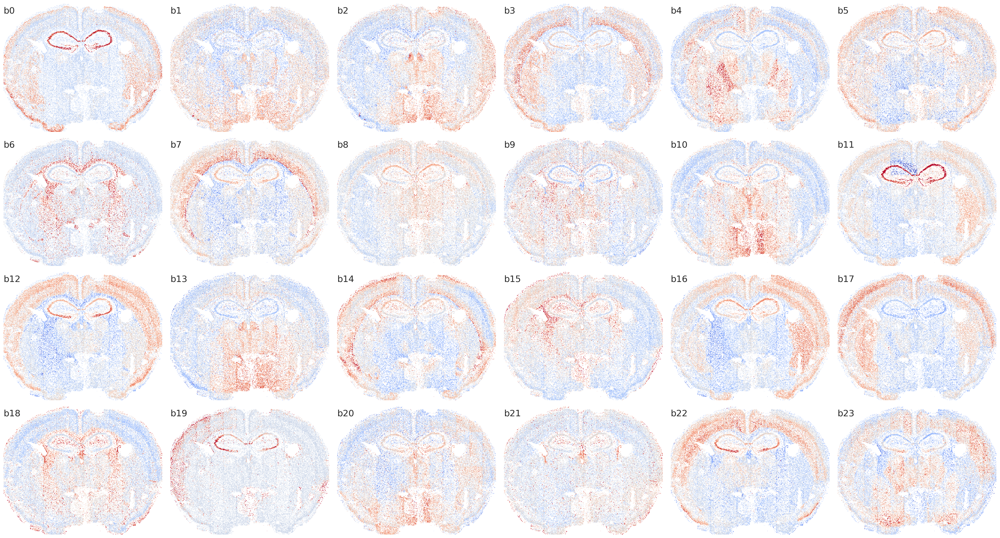

CPU times: user 21.6 s, sys: 403 ms, total: 22 s
Wall time: 22 s


In [14]:
%%time

plot_basis_spatial(df)

300 256


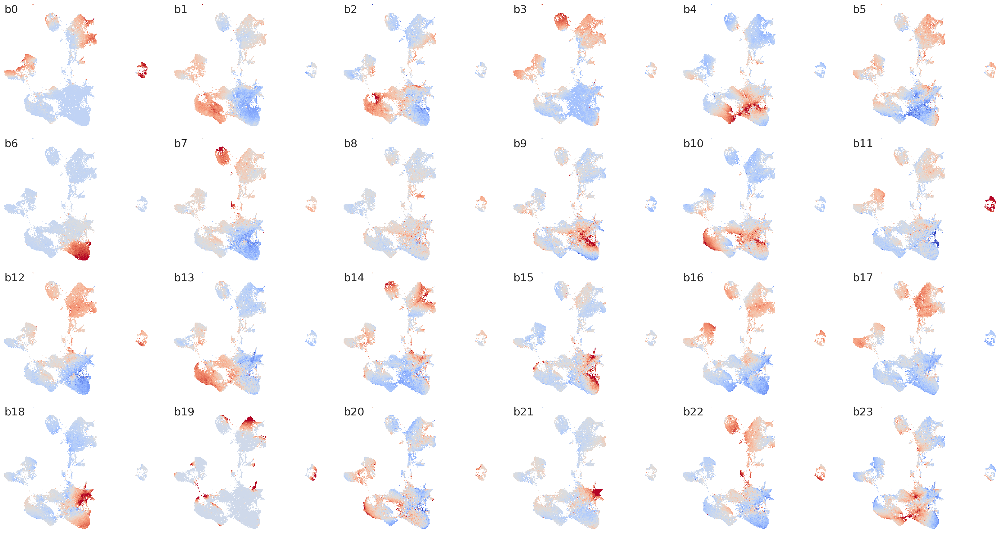

CPU times: user 20 s, sys: 287 ms, total: 20.3 s
Wall time: 20.3 s


In [15]:
%%time
plot_basis_umap(df)

235 375


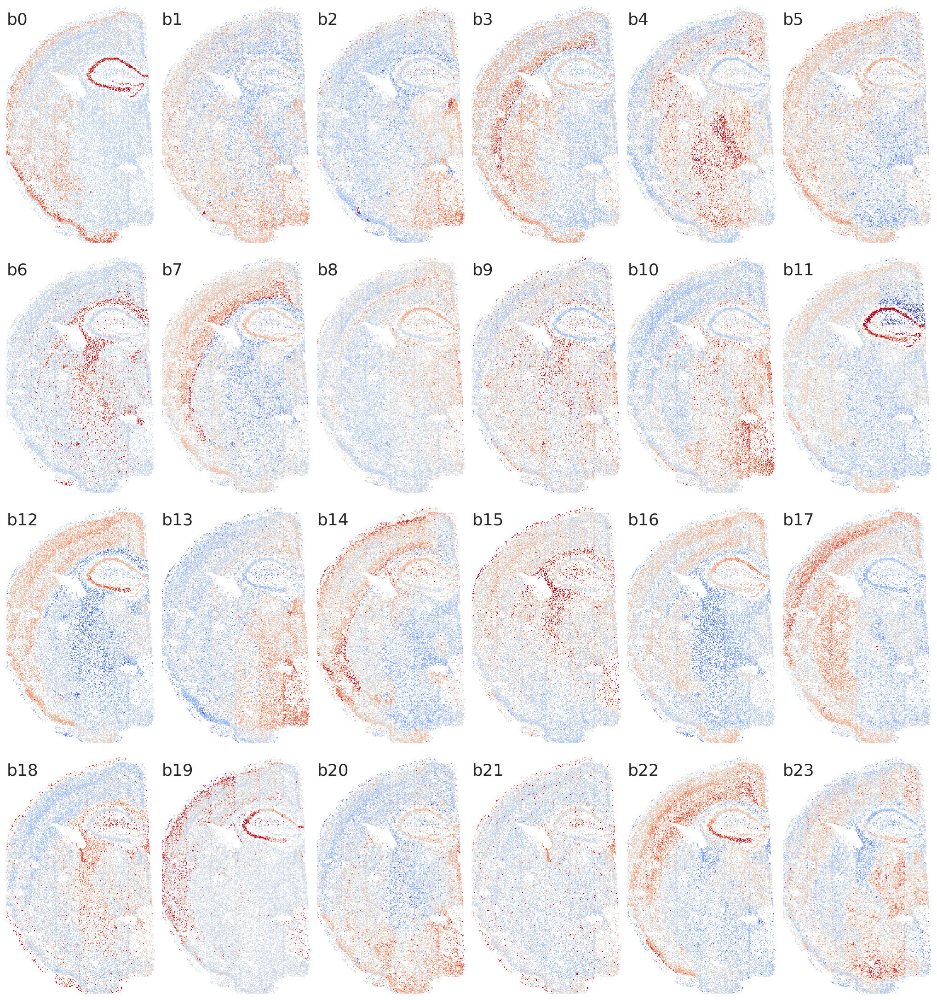

241 366


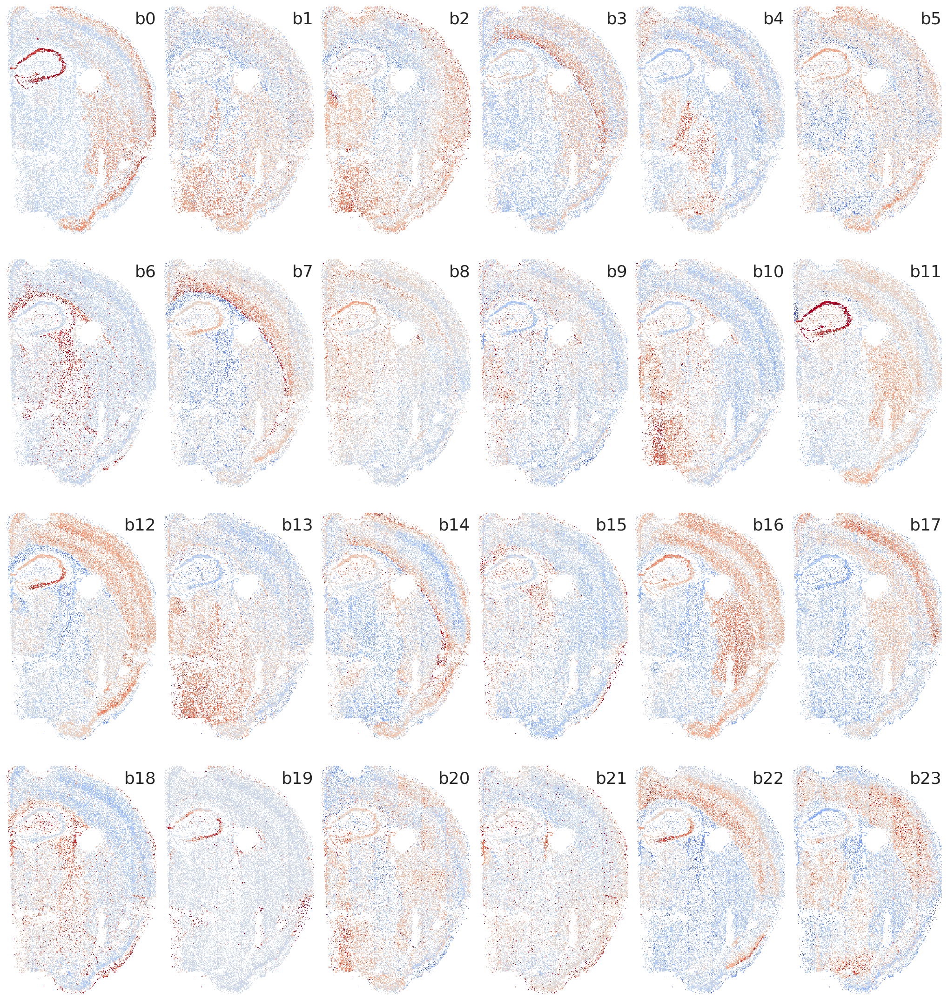

CPU times: user 3.96 s, sys: 46.8 ms, total: 4.01 s
Wall time: 3.98 s


In [16]:
%%time
dfsub = df[df['semi']==0]
plot_basis_spatial(dfsub, pmode='left_half')
# plot_basis_umap(dfsub)

dfsub = df[df['semi']==1]
plot_basis_spatial(dfsub, pmode='right_half')


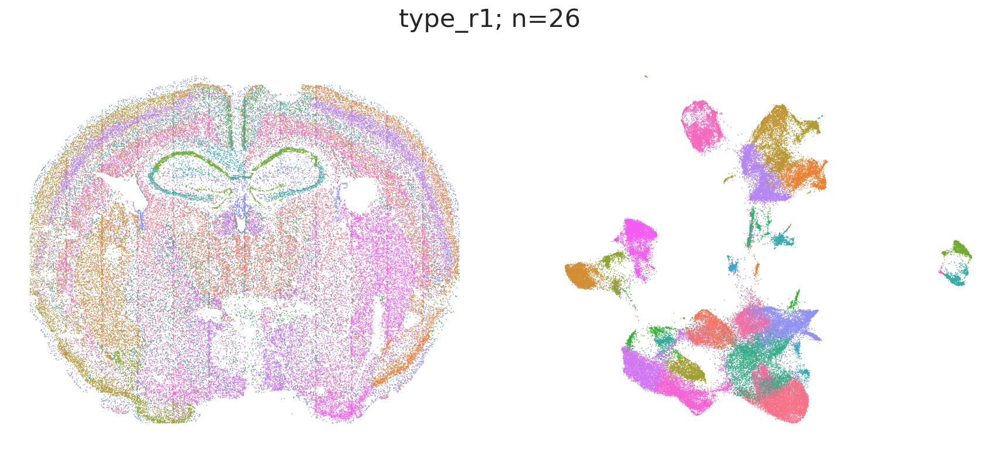

CPU times: user 2.48 s, sys: 11.4 ms, total: 2.49 s
Wall time: 2.47 s


In [ ]:
%%time
hue = 'type_r1'
hue_order = np.sort(np.unique(df[hue]))
ntypes = len(hue_order)
        
fig, axs = plt.subplots(1, 2, figsize=(8*2,6))
fig.suptitle(f"{hue}; n={ntypes}")
ax = axs[0]
sns.scatterplot(data=df, x='x', y='y', 
                hue=hue, hue_order=hue_order, 
                s=0.5, edgecolor=None, 
                legend=False,
                ax=ax)
# ax.legend(loc='upper left', bbox_to_anchor=(0, -0.1), ncol=5)
ax.set_aspect('equal')
ax.axis('off')

ax = axs[1]
sns.scatterplot(data=df, x='umap_x', y='umap_y', 
                hue=hue, hue_order=hue_order, 
                s=0.5, edgecolor=None, 
                legend=False,
                ax=ax)
# ax.legend(loc='upper left', bbox_to_anchor=(0, -0.1), ncol=5)
ax.set_aspect('equal')
ax.axis('off')
fig.subplots_adjust(wspace=0)
plt.show()

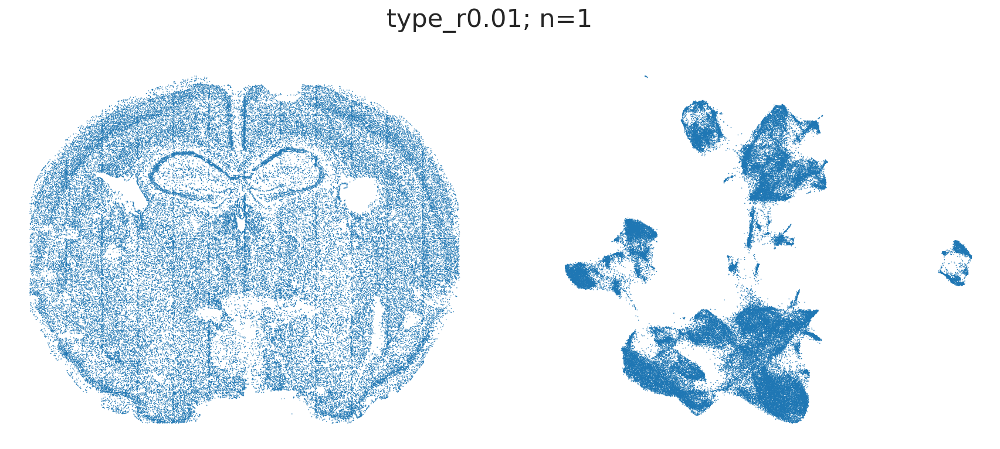

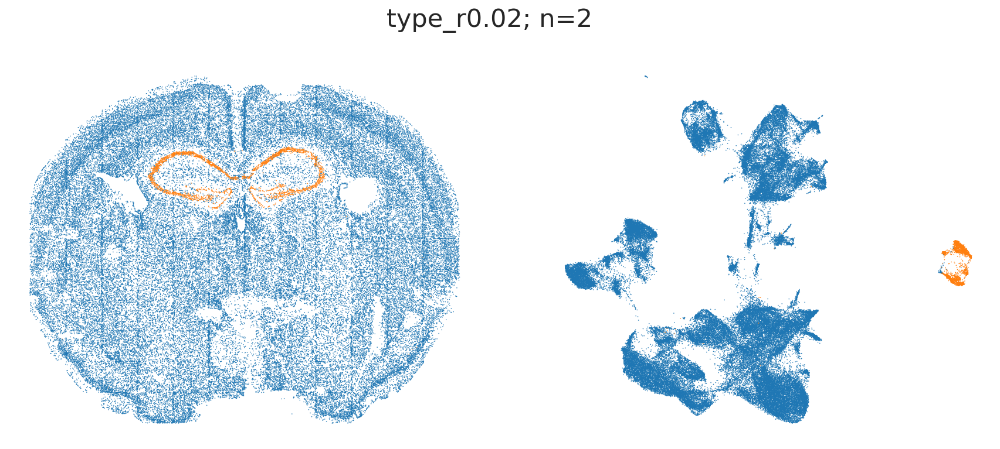

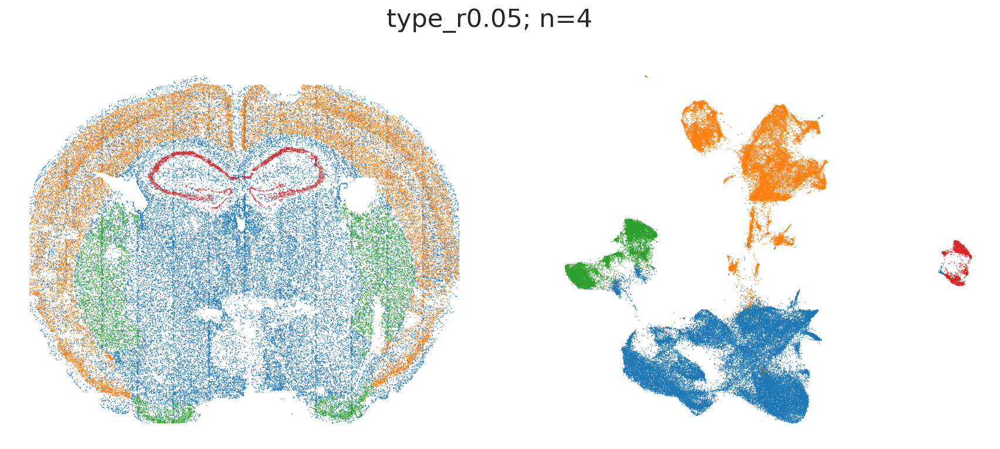

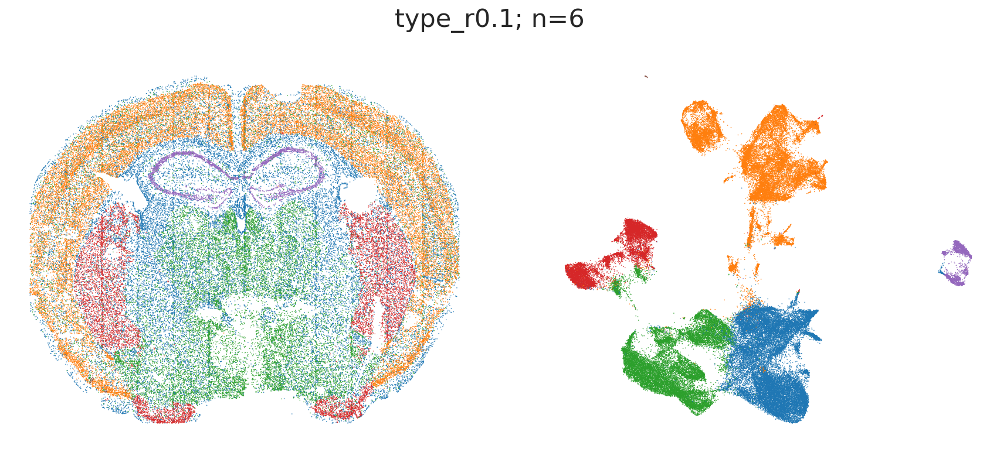

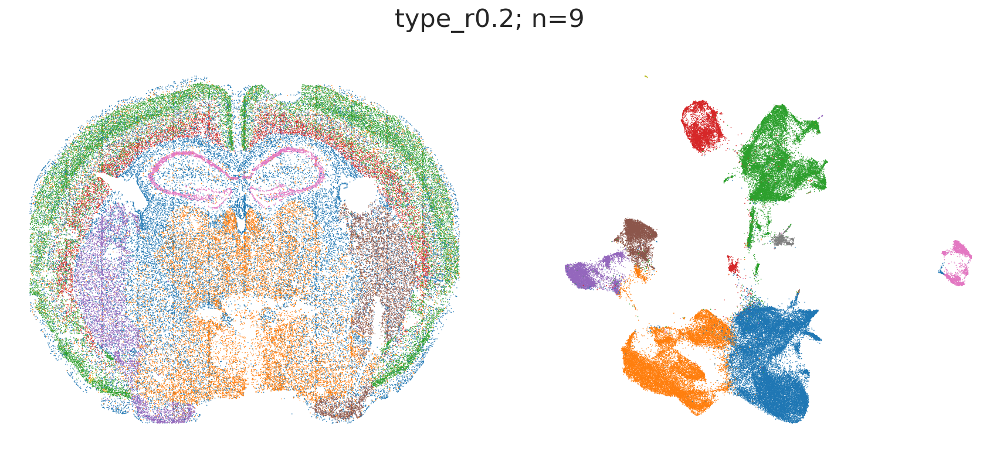

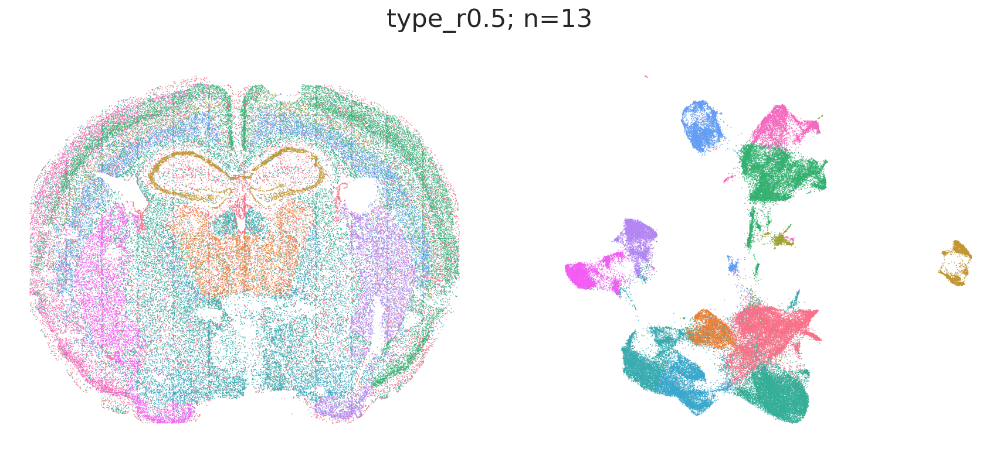

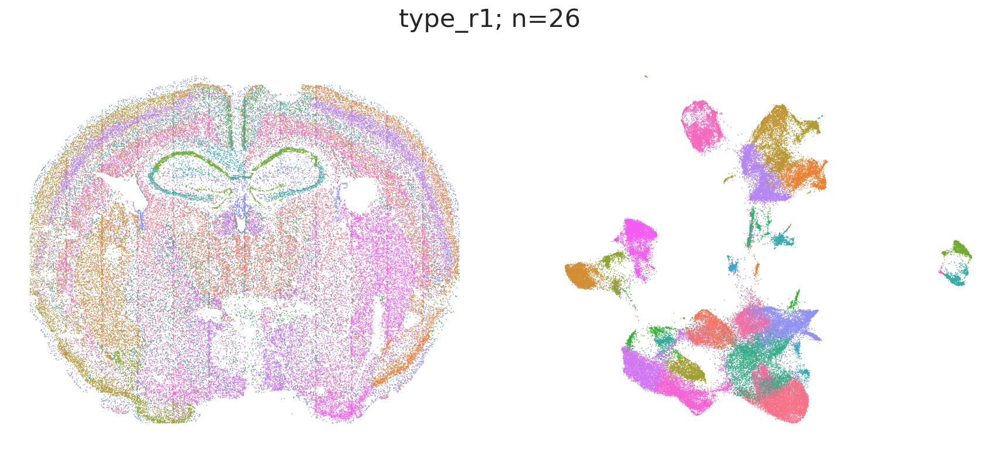

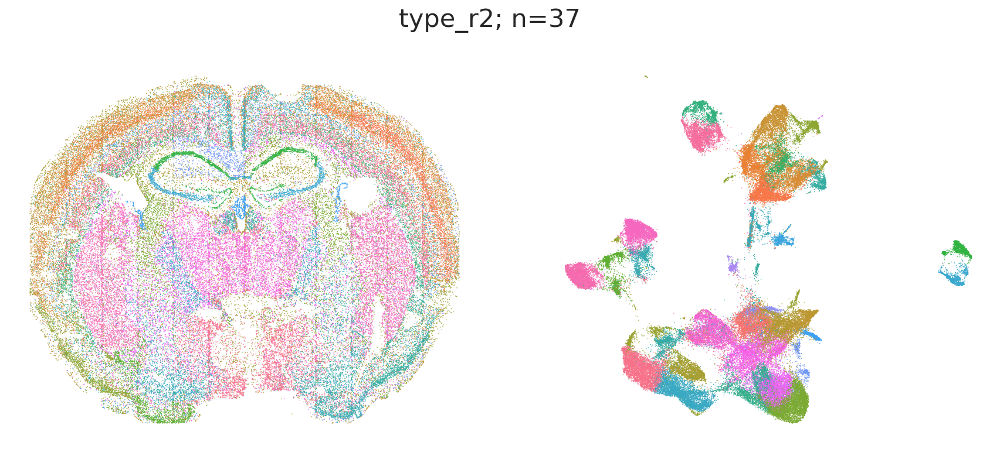

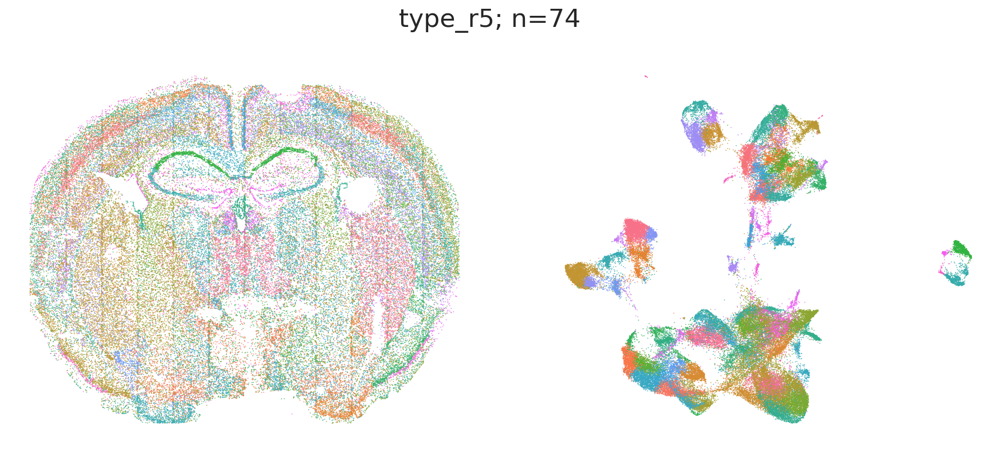

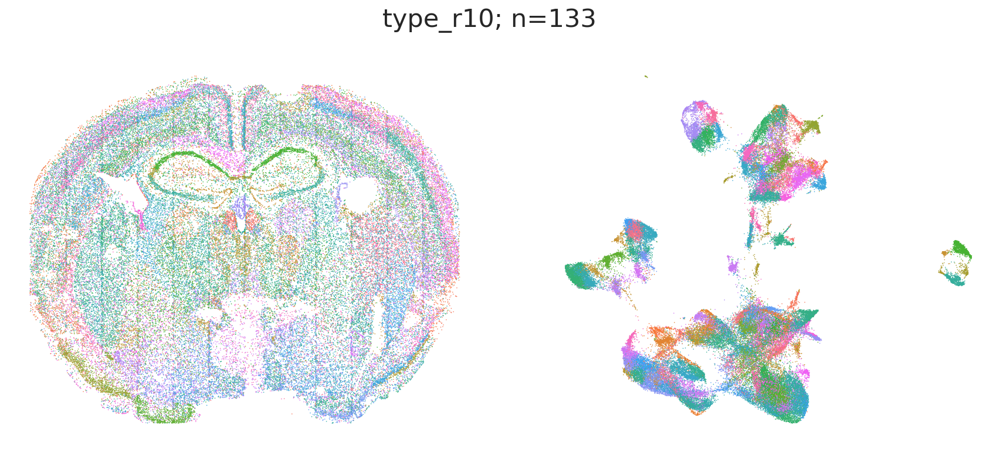

In [23]:
for r in resolutions:
    hue = f'type_r{r}'
    hue_order = np.sort(np.unique(df[hue]))
    ntypes = len(hue_order)

    fig, axs = plt.subplots(1, 2, figsize=(8*2,6))
    fig.suptitle(f"{hue}; n={ntypes}")
    ax = axs[0]
    sns.scatterplot(data=df, x='x', y='y', 
                    hue=hue, hue_order=hue_order, 
                    s=0.5, edgecolor=None, 
                    legend=False,
                    ax=ax)
    # ax.legend(loc='upper left', bbox_to_anchor=(0, -0.1), ncol=5)
    ax.set_aspect('equal')
    ax.axis('off')

    ax = axs[1]
    sns.scatterplot(data=df, x='umap_x', y='umap_y', 
                    hue=hue, hue_order=hue_order, 
                    s=0.5, edgecolor=None, 
                    legend=False,
                    ax=ax)
    # ax.legend(loc='upper left', bbox_to_anchor=(0, -0.1), ncol=5)
    ax.set_aspect('equal')
    ax.axis('off')
    fig.subplots_adjust(wspace=0)
    plt.show()